In [5]:
import rasterio as rio
import matplotlib.pyplot as plt
from rasterio.plot import show
from mpl_toolkits import mplot3d
import numpy as np
import os
import plotly.express as px
import pandas as pd

# TLS Data

TLS data is usually stored as "point cloud data" which helps in reconstructs scans in 3D (or otherwise). The data is a essentially a set of Cartesian coordinates as X,Y,Z describing the shape boundaries.

# Getting data

There's no central/popular data repository for TLS/ALS data. Though OpenTopography has a decent list of available [datasets](https://portal.opentopography.org/datasets) for TLS/ALS Data.

# Reading Data

Data can be read using ```loadtxt``` function from Numpy.

Data source for the below can be accessed [here](http://lucid.wur.nl/datasets/terrestrial-lidar-of-tropical-forests)

In [2]:
#Read the TLS data as a text file
file=np.loadtxt('Downloads/1_LidarTreePoinCloudData/4_LidarTreePoinCloudData/GUY01_000.txt')

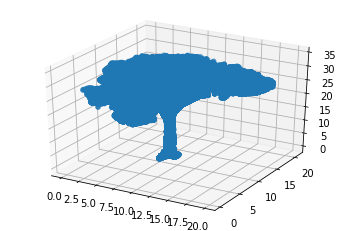

In [3]:
#create a scatter plot axis as a 3D projection
ax = plt.axes(projection='3d')

#Plot thr points by passing them as X,Y and Z coordinates
ax.scatter(file[:,0],file[:,1],file[:,2])

In [4]:
#Reduce size of dataset, to make 3D ploting with "px" smoother and faster, and rename column names
tree=pd.DataFrame(data=file[:100000,], columns=['x','y','z'])

In [5]:
#Use px to plot an interactive scatter plot
fig=px.scatter_3d(tree,'x', 'y', 'z', color='z')

#Set margins
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))

#Show plot
fig.show()

# ALS Data

ALS data is usually found in ```las``` or ```laz``` (which is a lossless compression of LAS) file formats. Data for the demo below can be found [here](https://portal.opentopography.org/dataspace/dataset?opentopoID=OTDS.022019.32616.2)

# Reading ALS Data

For reading ALS data the ```pylas``` library is used. Documentation can be found [here](https://pylas.readthedocs.io/en/latest/index.html). A good explanation of the data structure can be found [here](https://pylas.readthedocs.io/en/latest/intro.html#point-records)


In [8]:
import pylas

#Read LAZ file
las = pylas.read('Downloads/bz_hr_las10_crs.laz')

In [9]:
#Extract x,y,z data and store in dataframe
shape_3D=pd.DataFrame({'x':las.X,'y':las.Y,'z':las.Z})

In [10]:
#Plot a subset of the full dataset (due to performance limitations,  a.k.a my laptop)
fig=px.scatter_3d(shape_3D[:200000],'x', 'y', 'z', color='z')

#Set margins
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))

#Show plot
fig.show()